In [1]:
from get_gray_level import GetGrayLevel
from light_or_dark import LightOrDark
from is_shortcut import IsShortCut
import cv2
import numpy as np
from matplotlib import pyplot as plt
import os
from get_texts import GetTexts
from get_rectangle import GetRectangle
%matplotlib inline
%load_ext autoreload
%autoreload 2

## 明暗片图片

In [2]:
pic_path ='sample'
pic_names = os.listdir(pic_path)
paths = [pic_path + '\\'+name for name in pic_names]

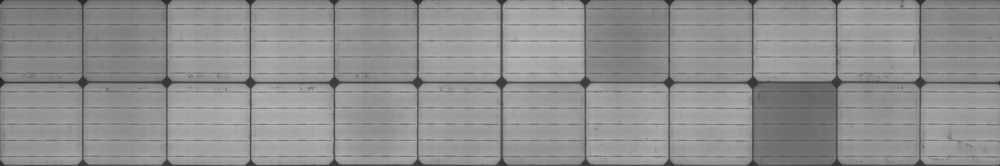
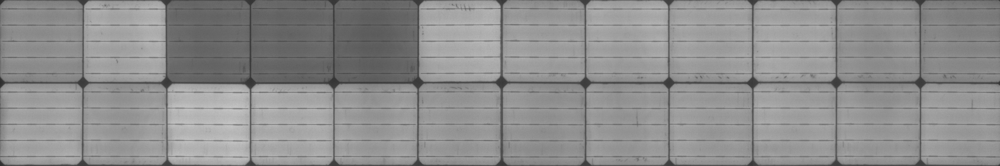
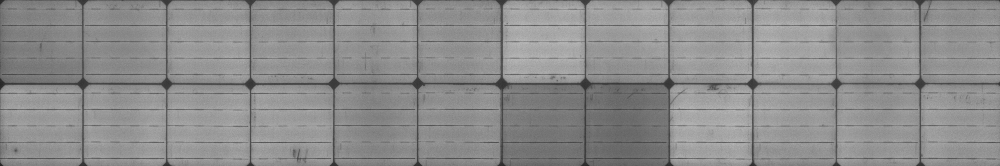

## 短路图片

In [10]:
pic_path ='sample_sc'
pic_names = os.listdir(pic_path)
paths = [pic_path + '\\'+name for name in pic_names]

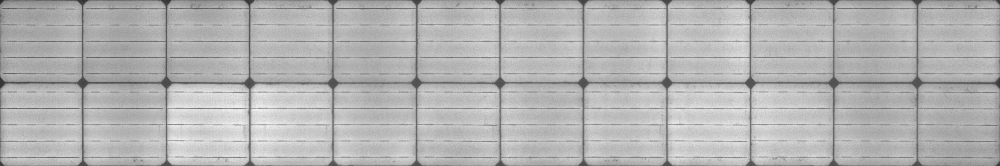
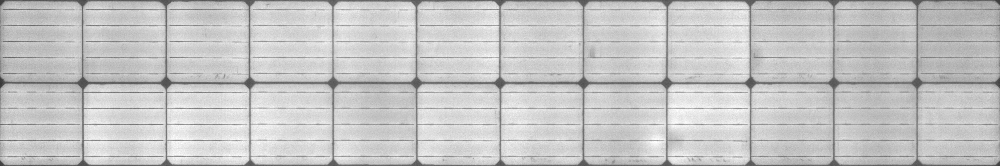
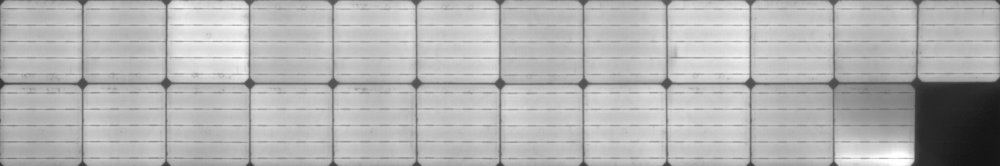

## 读入图片并获得电池片的灰度等级

In [11]:
pic1 = cv2.imread(paths[0], cv2.IMREAD_COLOR)
gray_mat1,cut_mat1 = GetGrayLevel(pic1, rows=2, cols=12)
pic2 = cv2.imread(paths[1], cv2.IMREAD_COLOR)
gray_mat2,cut_mat2 = GetGrayLevel(pic2, rows=2, cols=12)
pic3 = cv2.imread(paths[2], cv2.IMREAD_COLOR)
gray_mat3,cut_mat3 = GetGrayLevel(pic3, rows=2, cols=12)

## 明暗片识别主函数LightOrDark

In [5]:
results = LightOrDark(gray_mat1,cut_mat1, gray_mat2,cut_mat2, gray_mat3,cut_mat3, threshold=1)

## 短路识别主函数LightOrDark

In [12]:
results = IsShortCut(gray_mat1, cut_mat1, gray_mat2, cut_mat2, gray_mat3, cut_mat3, threshold=14)

## 给图片中的电池片标记灰度等级并框出有问题的电池片

In [13]:
pic1 = GetTexts(pic1, cut_mat1, gray_mat1, 2, 12)
pic2 = GetTexts(pic2, cut_mat2, gray_mat2, 2, 12)
pic3 = GetTexts(pic3, cut_mat3, gray_mat3, 2, 12)
    
test = np.concatenate((pic1, pic2, pic3), axis=0)
for j in range(len(results)):
    test = GetRectangle(list(results[j]['coord']), test)

## 输出结果

### 明暗片

In [8]:
cv2.imwrite('test.jpg', test)

True

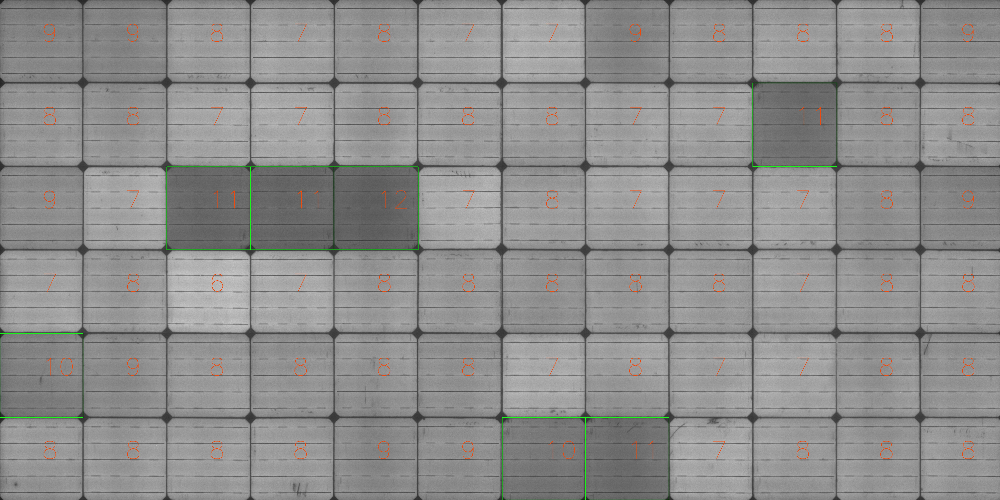

### 短路

In [14]:
cv2.imwrite('test_sc.jpg', test)

True

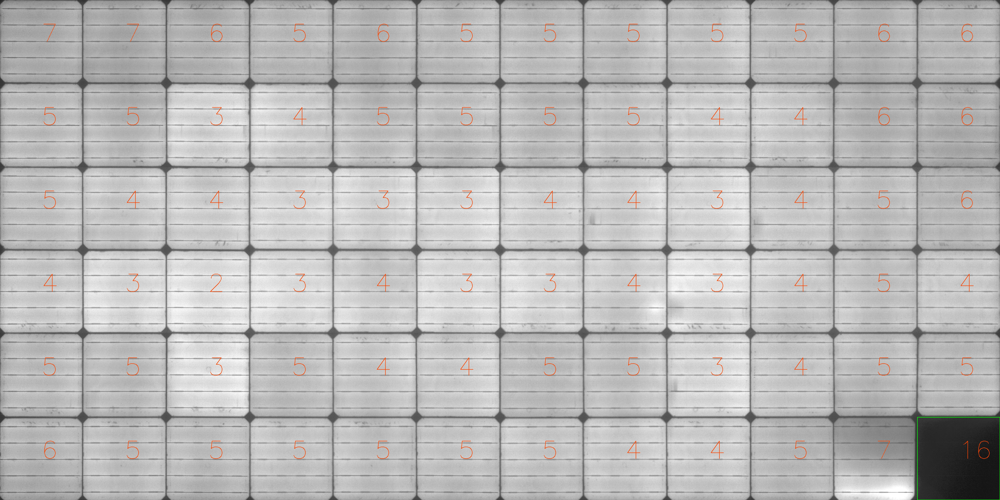